In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import bbknn
import os
from scipy import sparse
import collections
import scrublet as scr
import matplotlib.pyplot as plt
import time
import seaborn as sns
import random
import scipy
import scipy.io
import jp_single

sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=100, color_map='YlOrRd')
sc.logging.print_version_and_date()
# 用小鼠的骨骼肌干细胞整合一下

Running Scanpy 1.9.2, on 2023-06-20 10:03.


In [2]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells

In [3]:
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

***
Import data

In [4]:
raw_adata = sc.read('/public/LiuTL/jupyter_notebook/skeletal_muscle/mouse_muscle/write/Mouse_SKM_sc_summary_v1.0_adata_mouse_sc.h5ad')
adata_total = sc.read('/public/LiuTL/jupyter_notebook/skeletal_muscle/mouse_muscle/write/Mouse_SKM_bbknnv2_v1.0_adata_bbknnv1.h5ad')

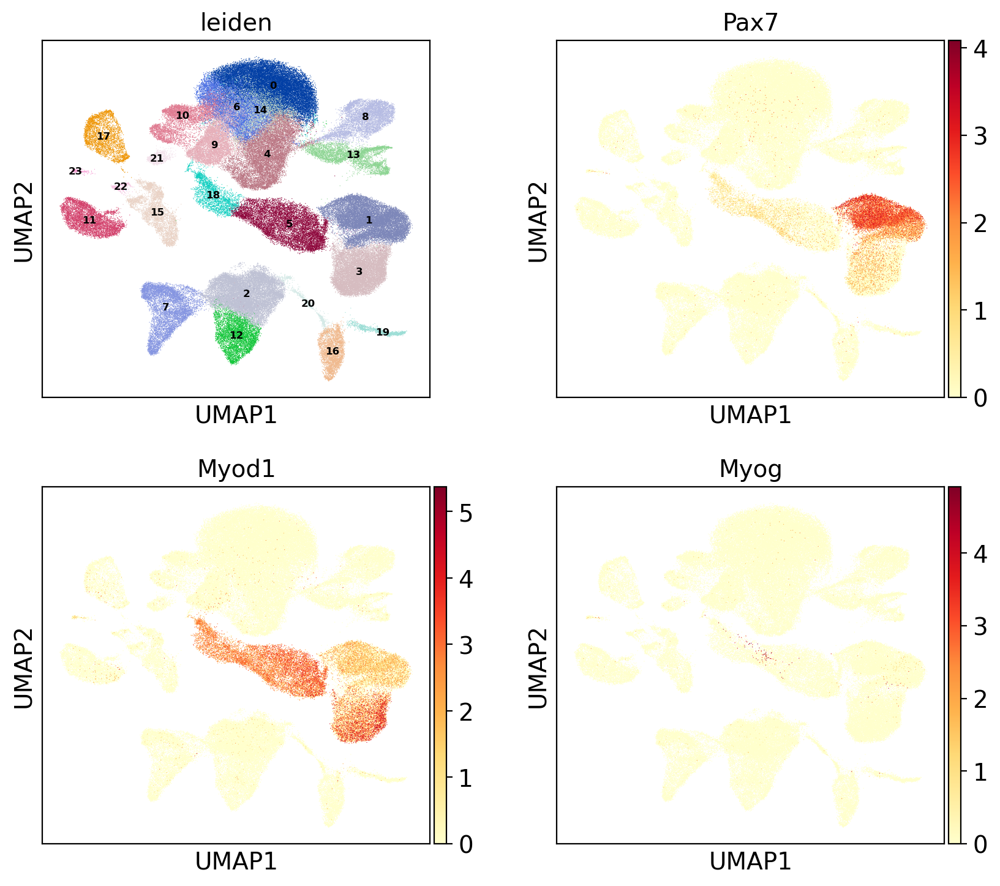

In [5]:
sc.pl.umap(adata_total,color=['leiden','Pax7','Myod1','Myog'],legend_loc='on data',legend_fontsize=6,ncols=2)

In [6]:
raw_adata

AnnData object with n_obs × n_vars = 148939 × 12349
    obs: 'batch', 'Age_bin', 'Age_mo', '10X_chemistry', 'Muscle', 'Source', 'Mito_per', 'Old_annotation', 'Sex', 'Sample_ID'
    var: 'mito', 'gene_ids-0', 'feature_types-0', 'genome-0', 'GeneName-0', 'n_cells-1'
    layers: 'counts'

In [7]:
cell_list1 = adata_total[adata_total.obs['leiden']=='1'].obs.index
cell_list2 = adata_total[adata_total.obs['leiden']=='3'].obs.index
cell_list3 = adata_total[adata_total.obs['leiden']=='5'].obs.index
cell_list4 = adata_total[adata_total.obs['leiden']=='18'].obs.index

cell_list = cell_list1.append(cell_list2).append(cell_list3).append(cell_list4)

In [8]:
adata = raw_adata[cell_list]

In [9]:
adata

View of AnnData object with n_obs × n_vars = 38001 × 12349
    obs: 'batch', 'Age_bin', 'Age_mo', '10X_chemistry', 'Muscle', 'Source', 'Mito_per', 'Old_annotation', 'Sex', 'Sample_ID'
    var: 'mito', 'gene_ids-0', 'feature_types-0', 'genome-0', 'GeneName-0', 'n_cells-1'
    layers: 'counts'

In [14]:
adata.obs['total_annotation'] = adata_total.obs['leiden']

Trying to set attribute `.obs` of view, copying.


In [15]:
adata.layers['counts'] = adata.X.copy()

In [16]:
adata

AnnData object with n_obs × n_vars = 38001 × 12349
    obs: 'batch', 'Age_bin', 'Age_mo', '10X_chemistry', 'Muscle', 'Source', 'Mito_per', 'Old_annotation', 'Sex', 'Sample_ID', 'total_annotation'
    var: 'mito', 'gene_ids-0', 'feature_types-0', 'genome-0', 'GeneName-0', 'n_cells-1'
    layers: 'counts'

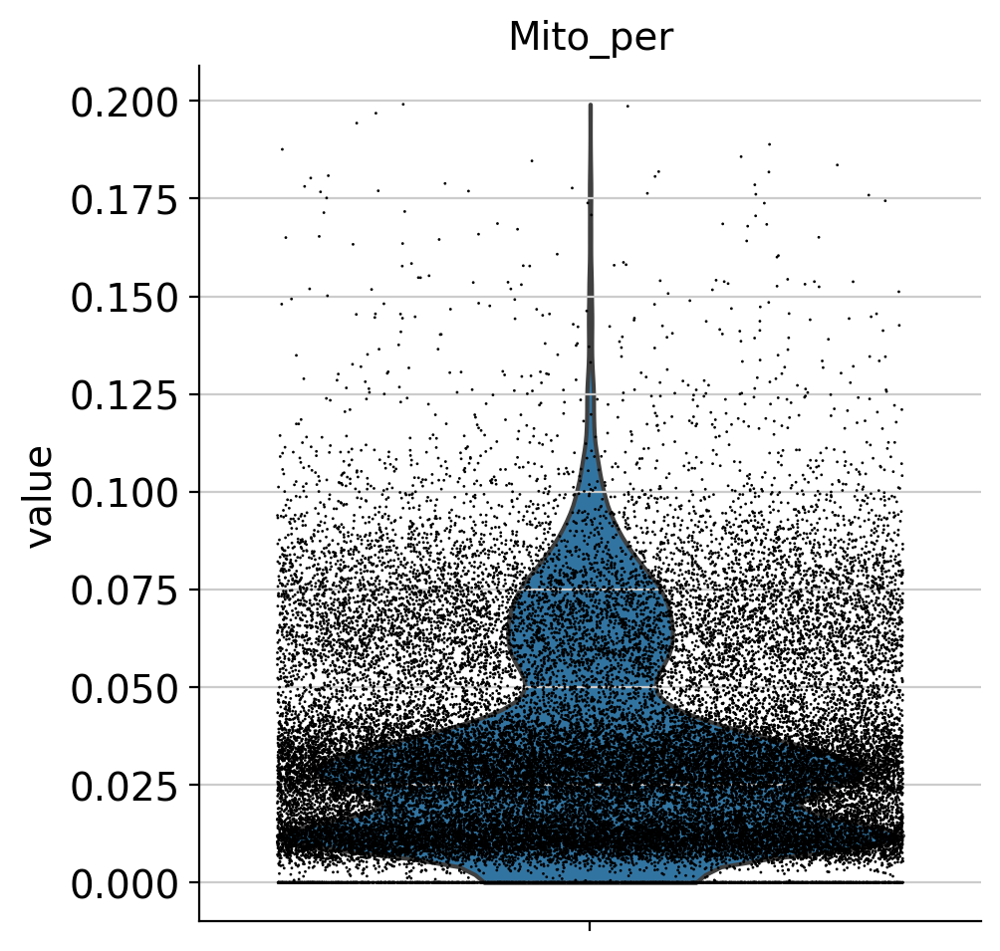

In [17]:
sc.pl.violin(adata,['Mito_per',],jitter=0.4, multi_panel=True)

In [18]:
sc.pp.calculate_qc_metrics(adata, inplace=True)

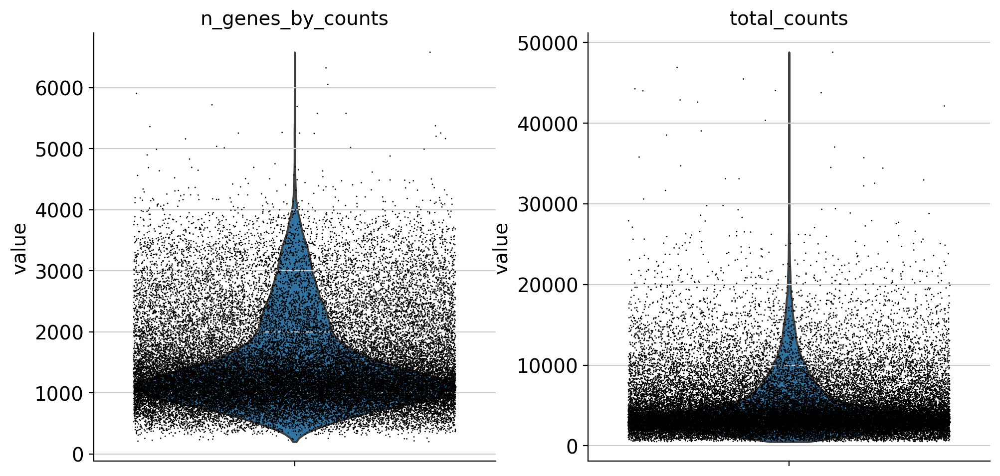

In [19]:
sc.pl.violin(adata,['n_genes_by_counts','total_counts',],jitter=0.4, multi_panel=True)

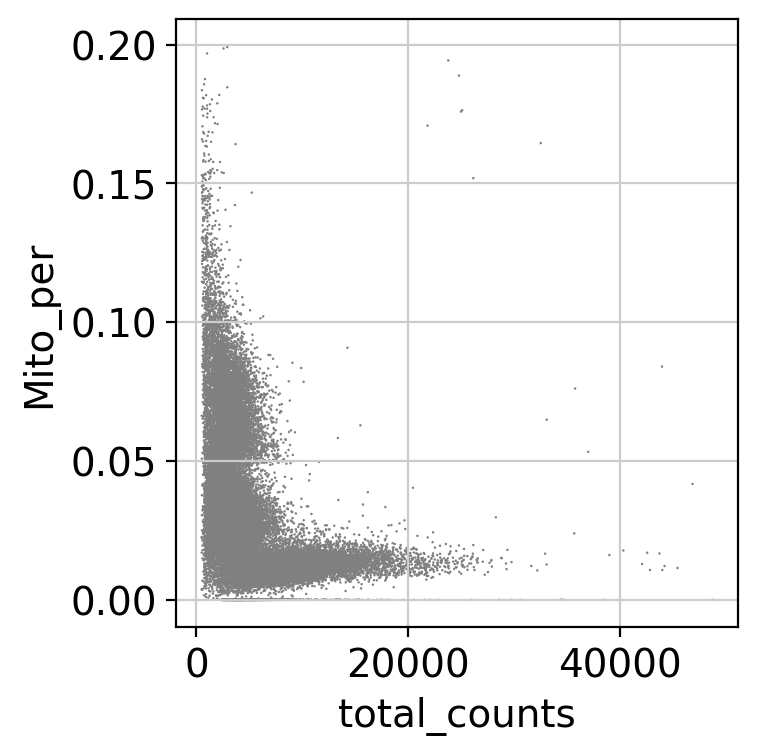

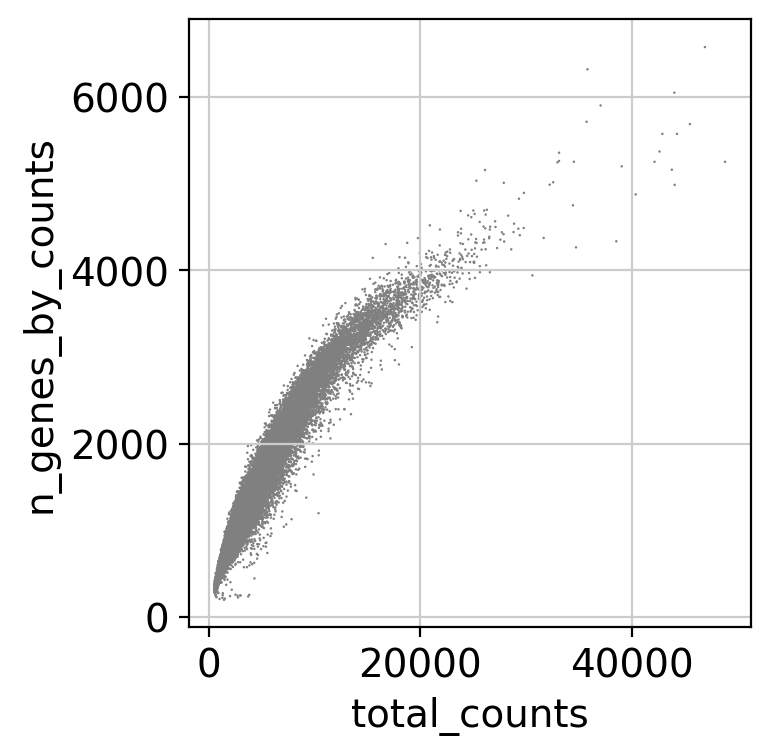

In [20]:
sc.pl.scatter(adata, x='total_counts', y='Mito_per')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [21]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after = 1e4)

normalizing by total count per cell
    finished (0:00:01): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [22]:
radata = adata.copy()

In [23]:
sc.pp.log1p(adata)

***
Highly veriable genes

extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


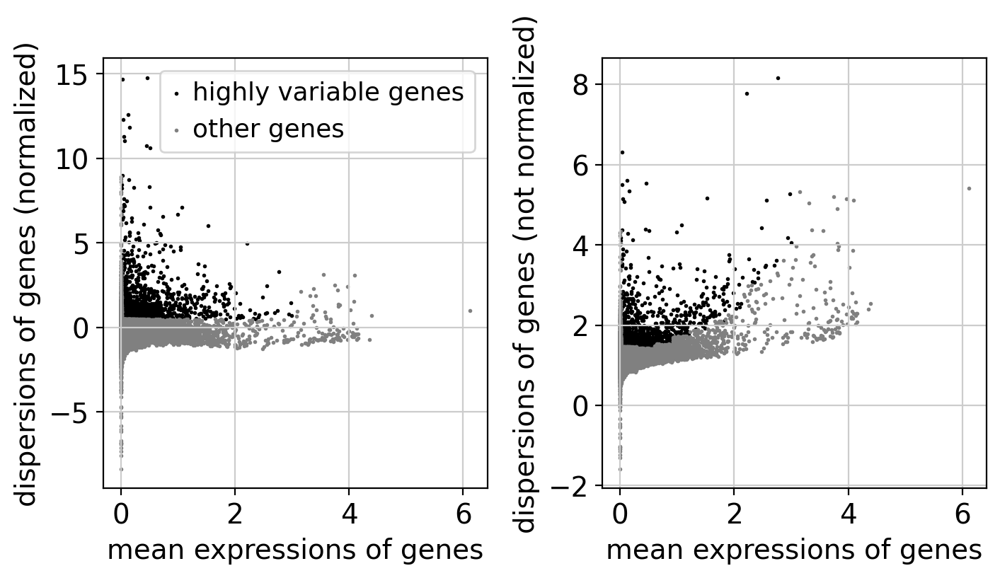

In [24]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)
adata.raw = adata
adata = adata[:, adata.var['highly_variable']]

In [24]:
# 这里考虑一下要不要regress 线粒体的比例
# sc.pp.regress_out(adata, ['total_counts','Mito_per'])

In [25]:
sc.pp.scale(adata, max_value=10)

/home/LiuTL/anaconda3/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [26]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)


In [27]:
adata

AnnData object with n_obs × n_vars = 38001 × 1657
    obs: 'batch', 'Age_bin', 'Age_mo', '10X_chemistry', 'Muscle', 'Source', 'Mito_per', 'Old_annotation', 'Sex', 'Sample_ID', 'total_annotation', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_counts'
    var: 'mito', 'gene_ids-0', 'feature_types-0', 'genome-0', 'GeneName-0', 'n_cells-1', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

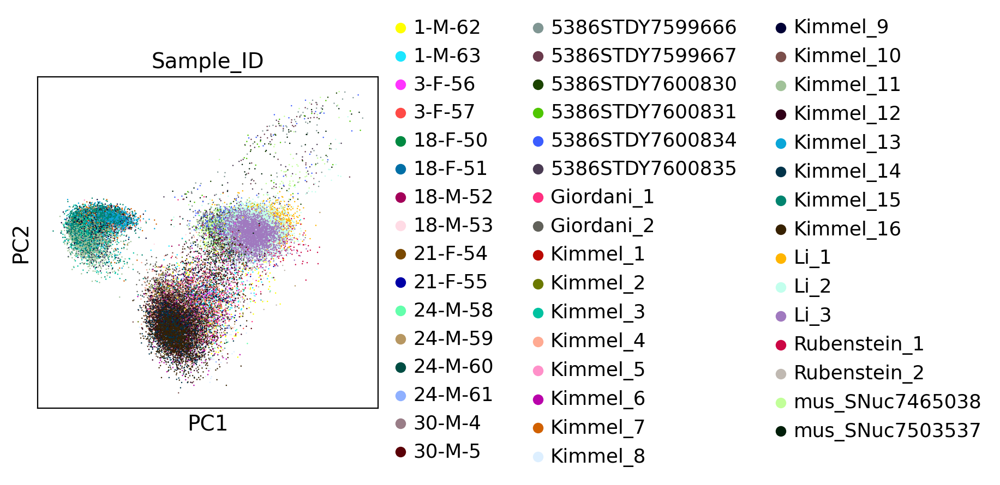

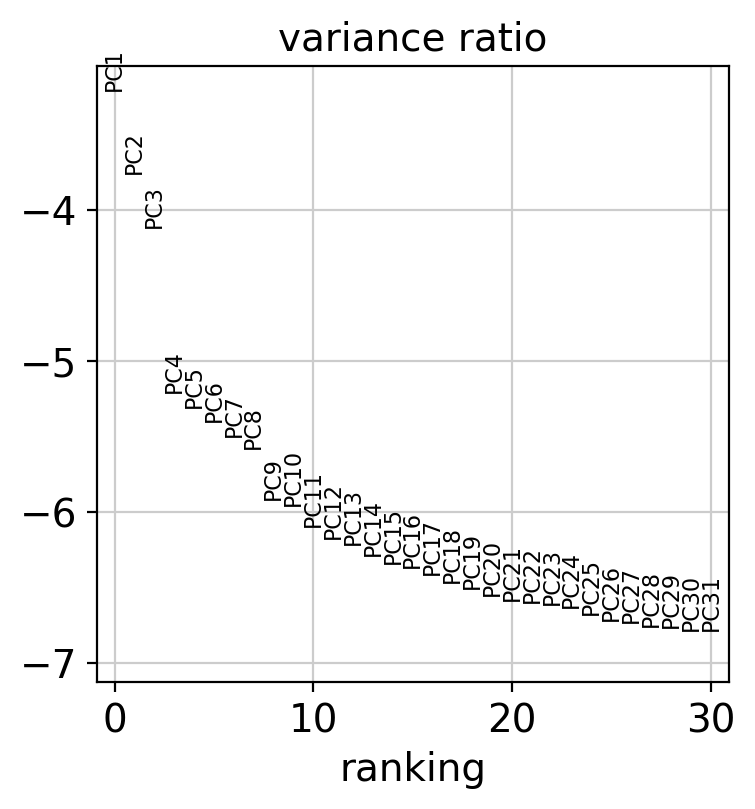

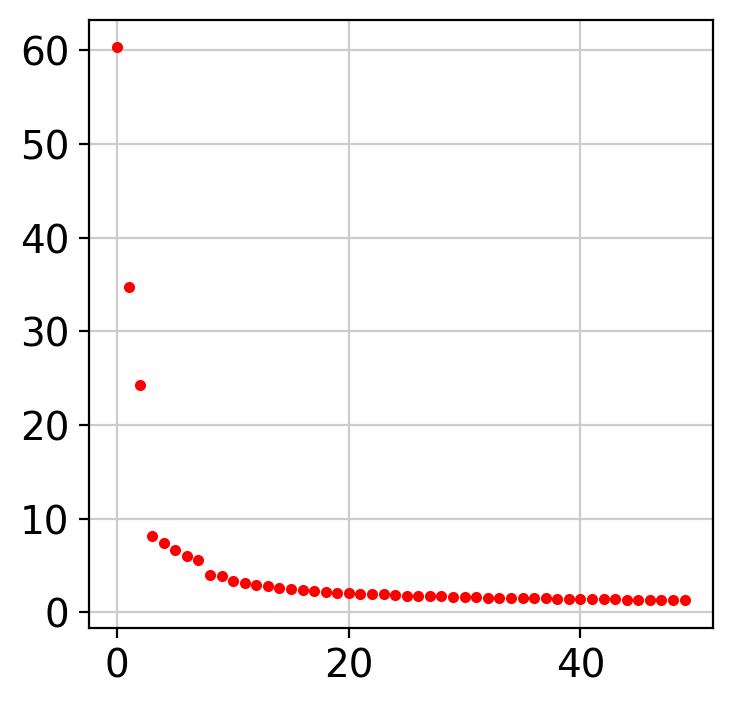

In [28]:
sc.pl.pca(adata,color='Sample_ID')
sc.pl.pca_variance_ratio(adata, log=True)
plt.plot(adata.uns['pca']['variance'],'r.')

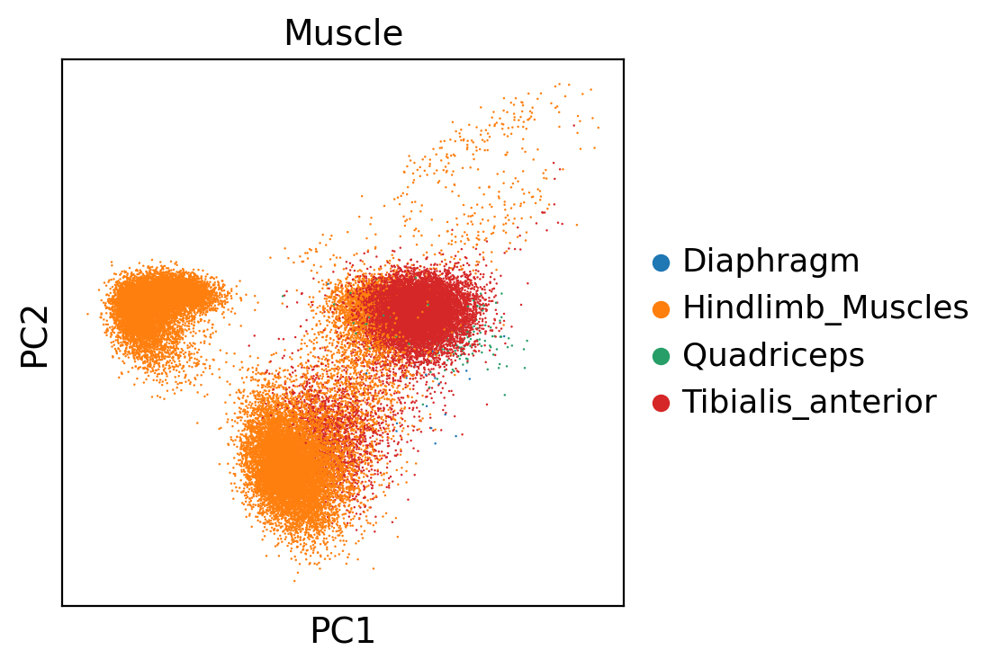

In [29]:
sc.pl.pca(adata,color='Muscle')

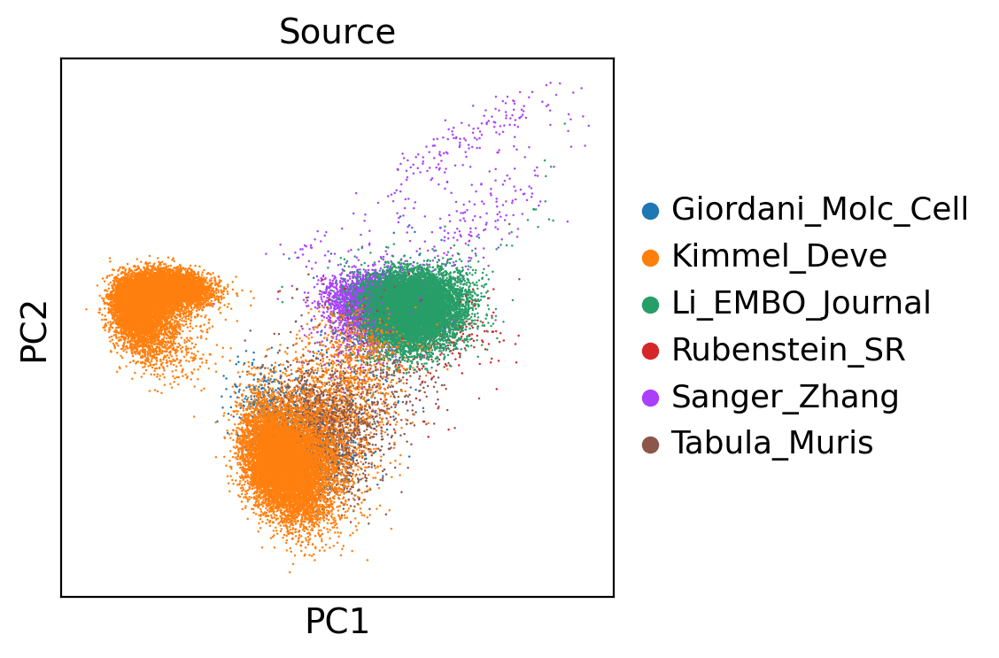

In [33]:
sc.pl.pca(adata,color='Source')

In [ ]:
PMID: 30922843, PMID: 32198156,PMID: 31736098,PMID: 31937892,PMID: 30283141

In [4]:
adata.write('./write/mouse_integrate_MuSC_bbknn_v1.0_adata.h5ad')

NameError: name 'adata' is not defined

In [4]:
adata = sc.read('./write/mouse_integrate_MuSC_bbknn_v1.0_adata.h5ad')

In [5]:
number_pcs = 15

In [25]:
adata_bbknn_scale_v1.write('./write/mouse_integrate_MuSC_bbknn_v1.0_adata_bbknn.h5ad')

In [31]:
adata_bbknn_scale_v2.write('./write/mouse_integrate_MuSC_bbknn_v1.0_adata_bbknn_scale_v2.h5ad')

In [4]:
adata_bbknn_scale_v1 = sc.read('./write/mouse_integrate_MuSC_bbknn_v1.0_adata_bbknn.h5ad')

In [4]:
adata_bbknn_scale_v2 = sc.read('./write/mouse_integrate_MuSC_bbknn_v1.0_adata_bbknn_scale_v2.h5ad')

In [5]:
adata_bbknn_scale_v2

AnnData object with n_obs × n_vars = 37482 × 1657
    obs: 'batch', 'Age_bin', 'Age_mo', '10X_chemistry', 'Muscle', 'Source', 'Mito_per', 'Old_annotation', 'Sex', 'Sample_ID', 'total_annotation', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_counts', 'leiden', 'annotation'
    var: 'mito', 'gene_ids-0', 'feature_types-0', 'genome-0', 'GeneName-0', 'n_cells-1', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Muscle_colors', 'Old_annotation_colors', 'Sample_ID_colors', 'Source_colors', 'annotation_colors', 'hvg', 'leiden', 'leiden_R_colors', 'leiden_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectiv

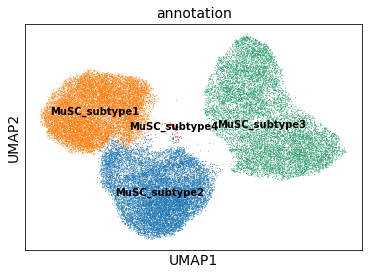

In [7]:
sc.pl.umap(adata_bbknn_scale_v2, color=['annotation'],legend_loc='on data')

In [9]:
adata_bbknn_scale_v2.obs['Source']

AAACGGGAGGTGCACA-1-0-0    Sanger_Zhang
AAACGGGGTGAGTGAC-1-0-0    Sanger_Zhang
AAAGATGTCGACGGAA-1-0-0    Sanger_Zhang
AAAGCAAGTTGGTTTG-1-0-0    Sanger_Zhang
AAAGTAGGTGGGTATG-1-0-0    Sanger_Zhang
                              ...     
TTTCCTCGTCGACTAT-15-5      Kimmel_Deve
TTTGGTTCAGTGACAG-15-5      Kimmel_Deve
TTTGTCAAGACAGACC-15-5      Kimmel_Deve
CGTCCATTCAACTCTT-3-5       Kimmel_Deve
TCAGATGCAGGCTGAA-7-5       Kimmel_Deve
Name: Source, Length: 37482, dtype: category
Categories (6, object): ['Giordani_Molc_Cell', 'Kimmel_Deve', 'Li_EMBO_Journal', 'Rubenstein_SR', 'Sanger_Zhang', 'Tabula_Muris']

In [11]:
adata_t = adata_bbknn_scale_v2[adata_bbknn_scale_v2.obs['Source']=='Tabula_Muris']

In [12]:
adata_t.obs

,batch,Age_bin,Age_mo,10X_chemistry,Muscle,Source,Mito_per,Old_annotation,Sex,Sample_ID,total_annotation,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,n_counts,leiden,annotation
AGAGCGAAGCATGGCA-1-14-0-0-1,1,old,18.0,v2,Tibialis_anterior,Tabula_Muris,0.0,skeletal muscle satellite cell,female,18-F-50,1,1332,7.195187,3370.0,8.122965,29.673591,44.272997,57.774481,75.311573,3370.0,9,MuSC_subtype2
CAGCTGGAGTGAAGTT-1-14-0-0-1,1,old,18.0,v2,Tibialis_anterior,Tabula_Muris,0.0,skeletal muscle satellite cell,female,18-F-50,1,1104,7.007601,4291.0,8.364508,43.486367,62.432999,74.248427,85.924027,4291.0,9,MuSC_subtype2
CGGAGTCGTAGCTAAA-1-14-0-0-1,1,old,18.0,v2,Tibialis_anterior,Tabula_Muris,0.0,skeletal muscle satellite cell,female,18-F-50,1,958,6.865891,3484.0,8.156223,46.785304,65.097589,75.200918,86.854191,3484.0,8,MuSC_subtype2
CTAACTTCAATGACCT-1-14-0-0-1,1,old,18.0,v2,Tibialis_anterior,Tabula_Muris,0.0,skeletal muscle satellite cell,female,18-F-50,1,826,6.717805,2672.0,7.890957,43.750000,61.227545,74.139222,87.799401,2672.0,9,MuSC_subtype2
CTACGTCCAGTCACTA-1-14-0-0-1,1,old,18.0,v2,Tibialis_anterior,Tabula_Muris,0.0,skeletal muscle satellite cell,female,18-F-50,1,974,6.882437,3311.0,8.105308,46.058593,62.035639,72.727273,85.684083,3311.0,8,MuSC_subtype2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CGTCCATGTATAGTAG-1-49-1-0-1,1,young,1.0,v2,Tibialis_anterior,Tabula_Muris,0.0,skeletal muscle satellite cell,male,1-M-63,18,2721,7.909122,14460.0,9.579210,31.396957,48.326418,60.587828,74.896266,14460.0,13,MuSC_subtype4
CGTGTAACACACAGAG-1-49-1-0-1,1,young,1.0,v2,Tibialis_anterior,Tabula_Muris,0.0,skeletal muscle satellite cell,male,1-M-63,18,3145,8.053887,17071.0,9.745195,30.642610,45.533361,58.696034,73.006854,17071.0,13,MuSC_subtype4
GTCACGGCACTTAACG-1-49-1-0-1,1,young,1.0,v2,Tibialis_anterior,Tabula_Muris,0.0,skeletal muscle satellite cell,male,1-M-63,18,2965,7.994970,17585.0,9.774858,32.300256,49.525163,62.052886,75.661075,17585.0,13,MuSC_subtype4
GTGTTAGCATGCATGT-1-49-1-0-1,1,young,1.0,v2,Tibialis_anterior,Tabula_Muris,0.0,skeletal muscle satellite cell,male,1-M-63,18,2573,7.853216,12131.0,9.403602,31.555519,49.798038,62.146567,75.657407,12131.0,13,MuSC_subtype4


***
BBKNN V1

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:46)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:14)


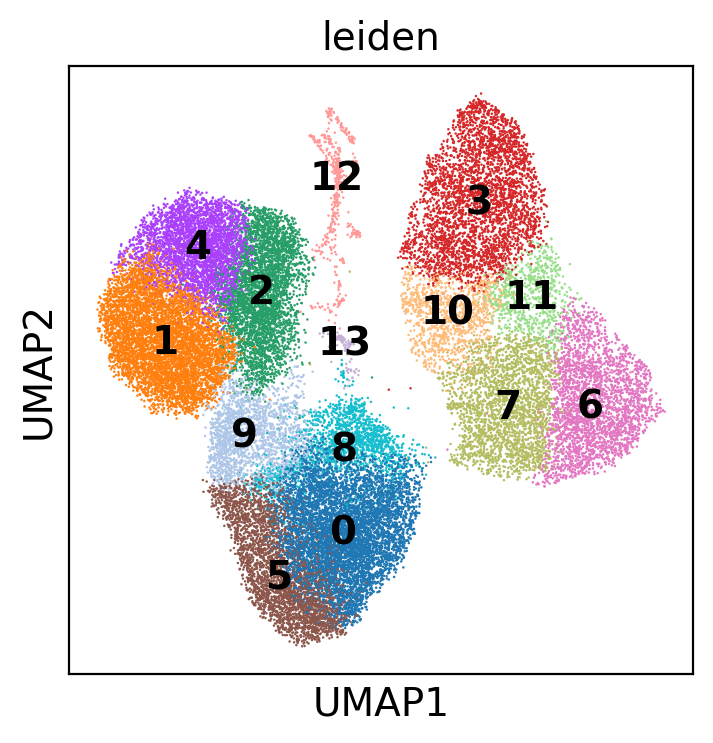

In [6]:
adata_bbknn_scale_v1 = bbknn.bbknn(adata,batch_key='Source',n_pcs=number_pcs,neighbors_within_batch=7,copy=True)
sc.tl.umap(adata_bbknn_scale_v1)
sc.tl.leiden(adata_bbknn_scale_v1,resolution=1)
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden'],legend_loc='on data')

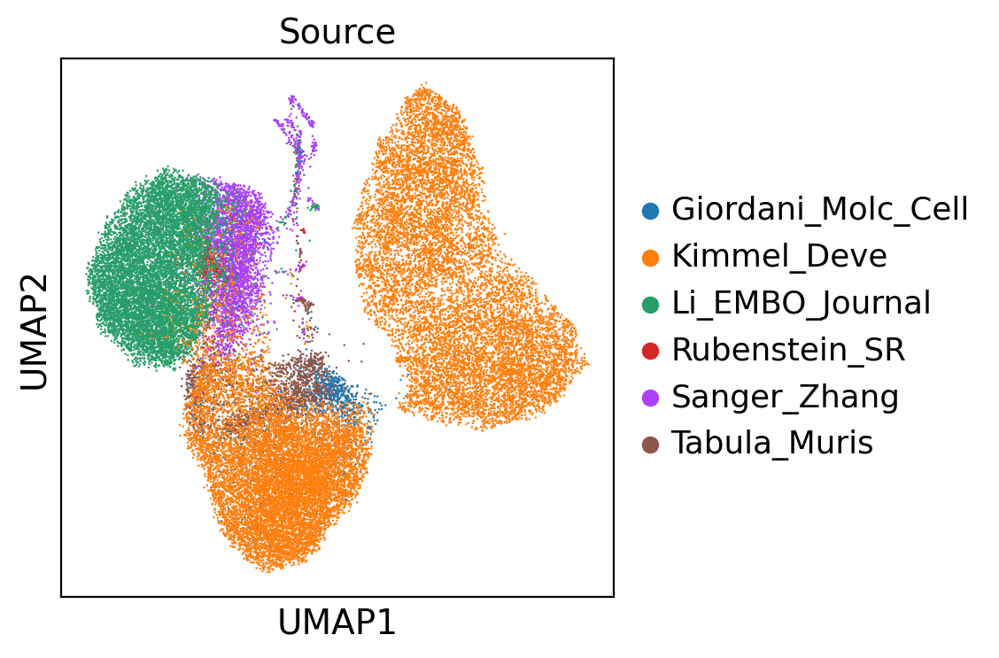

In [5]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Source'],)

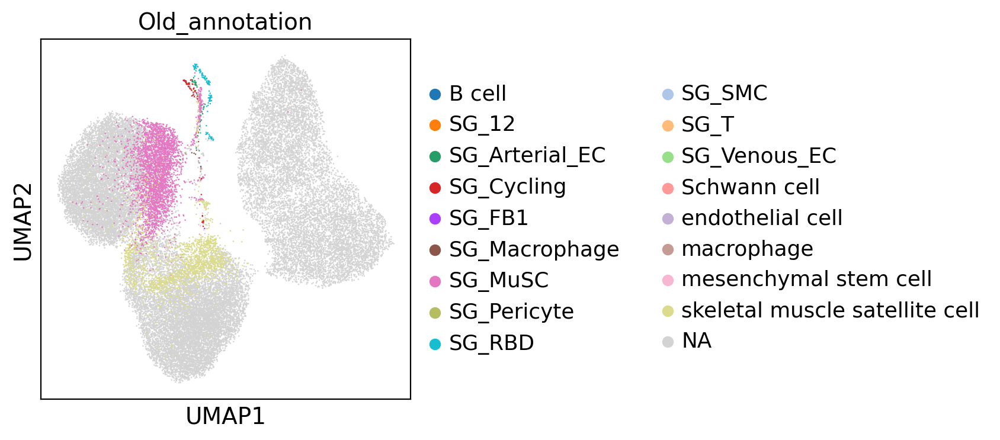

In [9]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Old_annotation'],)

In [ ]:
# adata_bbknn_scale_v2 

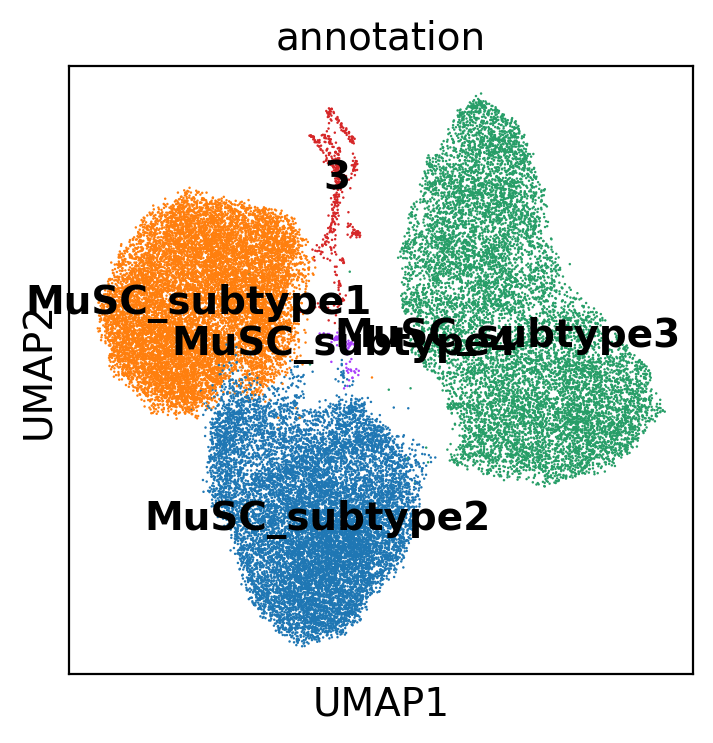

In [26]:
sc.pl.umap(adata_bbknn_scale_v1, color=['annotation'],legend_loc='on data')

In [10]:
adata_mix_index = list(adata_bbknn_scale_v1[adata_bbknn_scale_v1.obs['annotation']!='3'].obs.index)
adata_bbknn_scale_v2 = adata_bbknn_scale_v1[adata_mix_index]

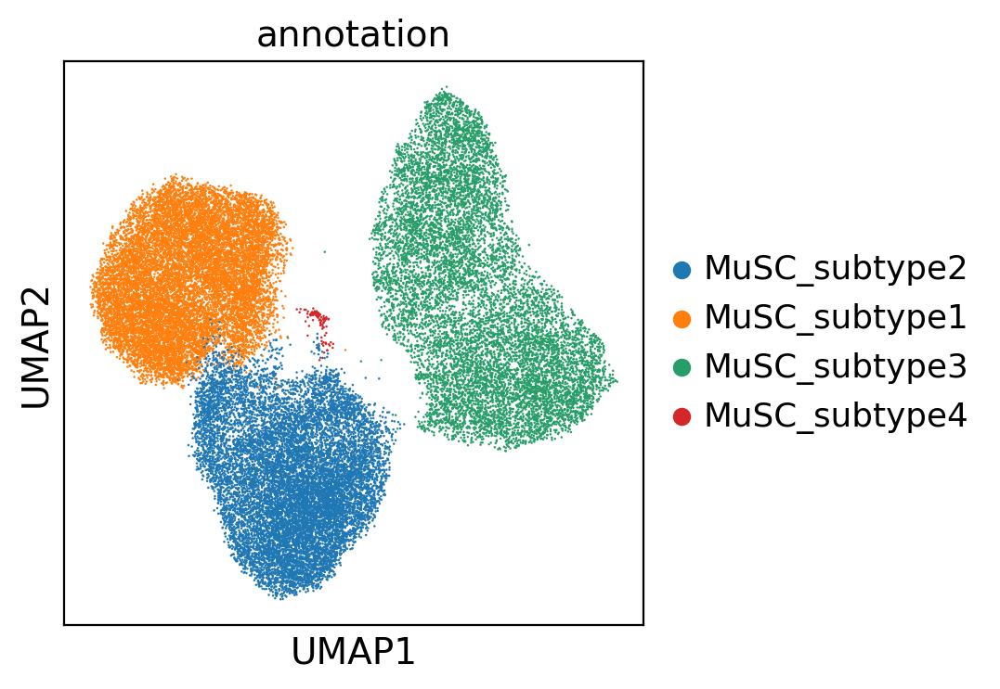

In [50]:
sc.pl.umap(adata_bbknn_scale_v2, color=['annotation'],save='mouse_integrate_MuSC_bbknn_v1.0_adata_bbknn_scale_v2_leiden.pdf')

Trying to set attribute `.uns` of view, copying.


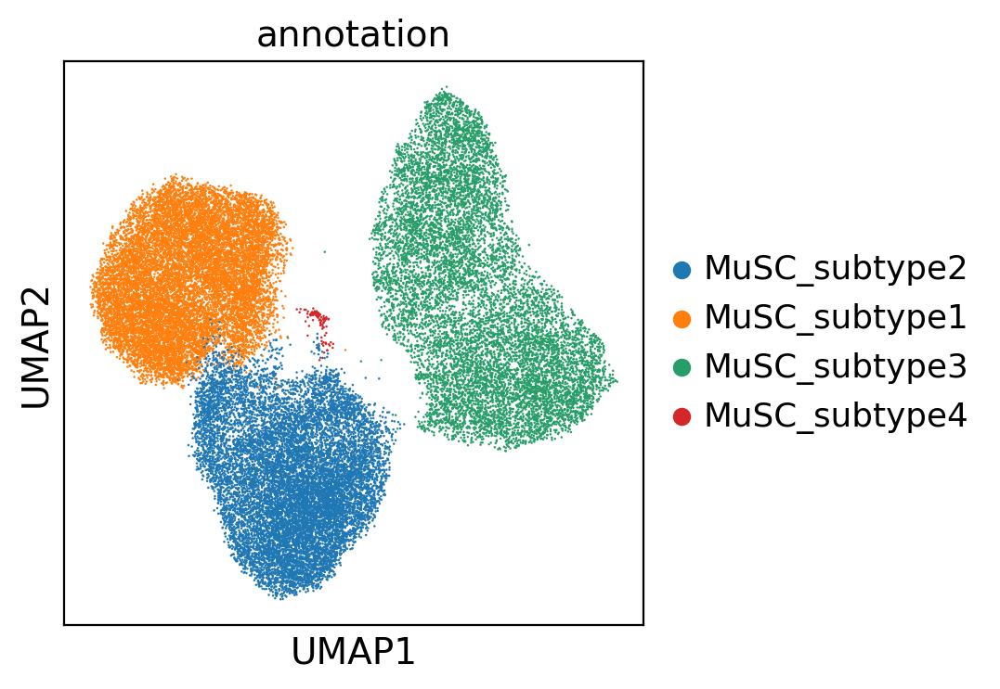

In [11]:
sc.pl.umap(adata_bbknn_scale_v2, color=['annotation'],)

In [ ]:
'NOP16', 'CLCF1', 'PNO1','SLC39A14','MEDAG', 'SRGAP1', 'PHC2', 'MT1X', 'ARID5A','APOL4', 'NIP7', 'NPTX2', 'MT1A', 'SEH1L', 'SRPRB', 'RCAN1', 'CHSY1', 'UTP4', 'OSMR', 'FOSL1', 'PTRH2', 'IL1R1', 'RRP9', 'FNDC4', 'SAMD4A',  'CTGF', 'UAP1', 'HNRNPAB', 'PPRC1', 'TRMT6', 'GLIS3', 'TOMM5', 'CASP4', 'RUNX1', 'SLC25A33', 'SLC4A7', 'TOMM40', 'DKC1', 'PRRX1', 'DDX21', 'APOL2', 'TSR1',  'GRWD1', 'C8orf33', 'ZNF593',  'HSPA6', 'ETS2', 'WDR43', 'GART', 'KHDRBS3', 'ELK3', 'RIOK1', 'PLSCR1', 'HPRT1', 'STK17A', 'NDUFAF4', 'UTP3', 'CDC42EP1', 'CD44'

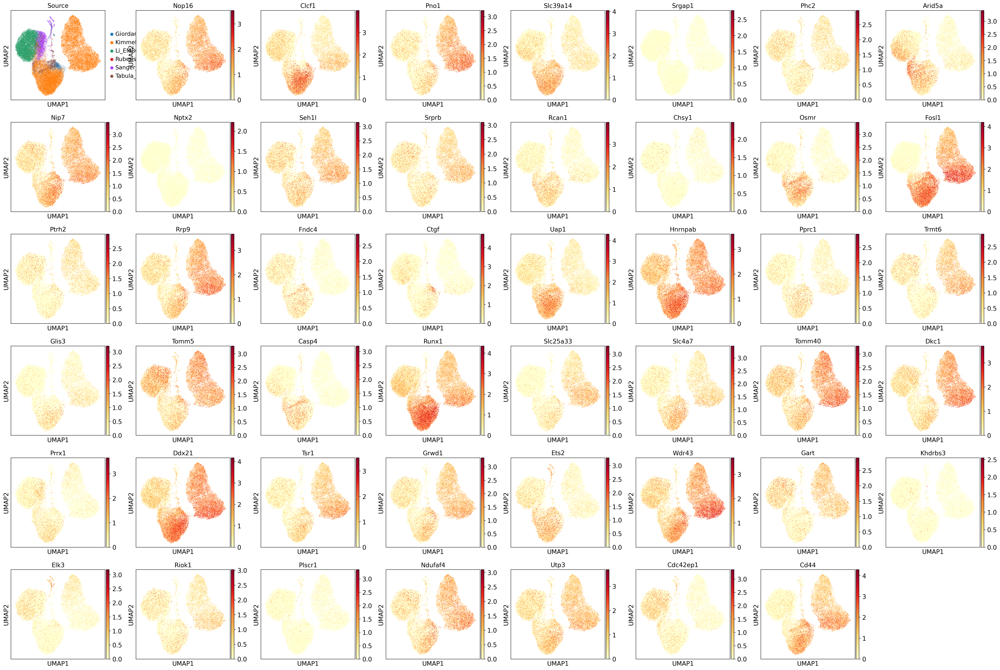

In [21]:
# TNFRsf12a marker gene
sc.pl.umap(adata_bbknn_scale_v1, color=['Source','Nop16', 'Clcf1', 'Pno1','Slc39a14','Srgap1', 'Phc2', 'Arid5a','Nip7', 'Nptx2', 'Seh1l', 'Srprb', 'Rcan1', 'Chsy1', 'Osmr', 'Fosl1', 'Ptrh2', 'Rrp9', 'Fndc4',
                                        'Ctgf', 'Uap1', 'Hnrnpab', 'Pprc1', 'Trmt6', 'Glis3', 'Tomm5', 'Casp4', 'Runx1', 'Slc25a33', 'Slc4a7', 'Tomm40', 'Dkc1', 'Prrx1', 'Ddx21', 'Tsr1',  'Grwd1',
                                        'Ets2', 'Wdr43', 'Gart', 'Khdrbs3', 'Elk3', 'Riok1', 'Plscr1',  'Ndufaf4', 'Utp3', 'Cdc42ep1', 'Cd44'],ncols=8)

In [74]:
adata_bbknn_scale_v1

AnnData object with n_obs × n_vars = 38001 × 1657
    obs: 'batch', 'Age_bin', 'Age_mo', '10X_chemistry', 'Muscle', 'Source', 'Mito_per', 'Old_annotation', 'Sex', 'Sample_ID', 'total_annotation', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_counts', 'leiden', 'annotation'
    var: 'mito', 'gene_ids-0', 'feature_types-0', 'genome-0', 'GeneName-0', 'n_cells-1', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Muscle_colors', 'Old_annotation_colors', 'Sample_ID_colors', 'Source_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'umap', 'annotation_colors', 'leiden_R_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectiv

In [ ]:
  'Srgap1', 'Phc2', 'Arid5a', 'Nptx2',   'Rcan1', 'Chsy1', 'Osmr',  'Ptrh2',  'Fndc4',
'Ctgf',   'Pprc1',  'Glis3',  'Casp4',     'Prrx1',    
'Ets2',   'Khdrbs3', 'Elk3',  'Plscr1',    'Cdc42ep1', 

In [2]:
for i in ['Tnfrsf12a','Nop16','Polr2k','Runx1','Ddx21','Hnrnpab','Fosl1','Wdr43',
                                   'Cd44','Uap1','Slc39a14','Clcf1','Tomm5','Rrp9','Pno1','Tomm40','Dkc1','Nip7','Seh1l','Slc25a33','Slc4a7',
                                   'Tsr1','Grwd1','Ndufaf4','Utp3','Trmt6','Srprb','Gart','Riok1']:
    print(i+',')

Tnfrsf12a,
Nop16,
Polr2k,
Runx1,
Ddx21,
Hnrnpab,
Fosl1,
Wdr43,
Cd44,
Uap1,
Slc39a14,
Clcf1,
Tomm5,
Rrp9,
Pno1,
Tomm40,
Dkc1,
Nip7,
Seh1l,
Slc25a33,
Slc4a7,
Tsr1,
Grwd1,
Ndufaf4,
Utp3,
Trmt6,
Srprb,
Gart,
Riok1,


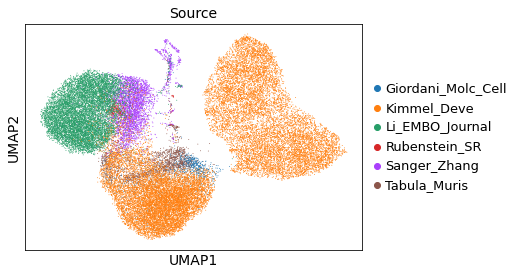

In [6]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Source'],)

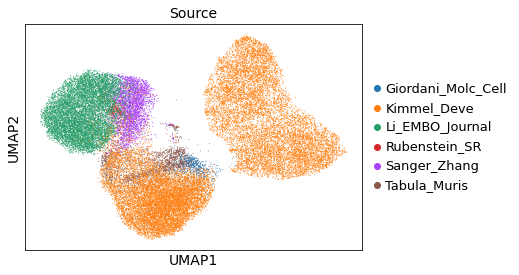

In [8]:
sc.pl.umap(adata_bbknn_scale_v2, color=['Source'],)

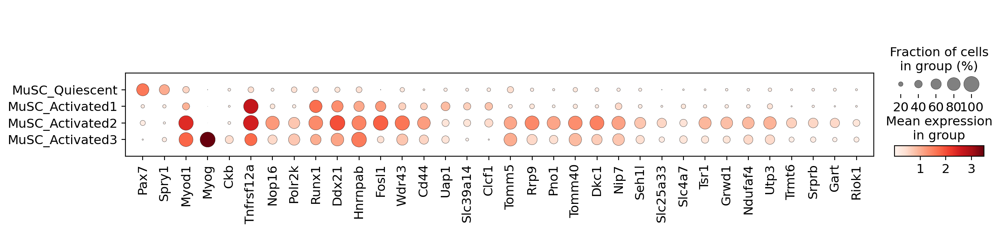

In [81]:
sc.pl.dotplot(adata_bbknn_scale_v1,['Pax7','Spry1','Myod1','Myog','Ckb','Tnfrsf12a','Nop16','Polr2k','Runx1','Ddx21','Hnrnpab','Fosl1','Wdr43',
                                   'Cd44','Uap1','Slc39a14','Clcf1','Tomm5','Rrp9','Pno1','Tomm40','Dkc1','Nip7','Seh1l','Slc25a33','Slc4a7',
                                   'Tsr1','Grwd1','Ndufaf4','Utp3','Trmt6','Srprb','Gart','Riok1',],groupby='annotation',categories_order=['MuSC_Quiescent','MuSC_Activated1','MuSC_Activated2','MuSC_Activated3'],
             save='mouse_integrate_MuSC_bbknn_v1.0_TNF_marker.pdf')

In [ ]:
sc.pl.dotplot(adata_bbknn_scale_v1,['Pax7','Spry1','Myod1','Myog','Ckb','Tnfrsf12a','Nop16','Polr2k','Runx1','Ddx21','Hnrnpab','Fosl1','Wdr43',
                                   'Cd44','Uap1','Slc39a14','Clcf1','Tomm5','Rrp9','Pno1','Tomm40','Dkc1','Nip7','Seh1l','Slc25a33','Slc4a7',
                                   'Tsr1','Grwd1','Ndufaf4','Utp3','Trmt6','Srprb','Gart','Riok1',],groupby='annotation',categories_order=['MuSC_Quiescent','MuSC_Activated1','MuSC_Activated2','MuSC_Activated3'],
             save='mouse_integrate_MuSC_bbknn_v1.0_TNF_marker.pdf')

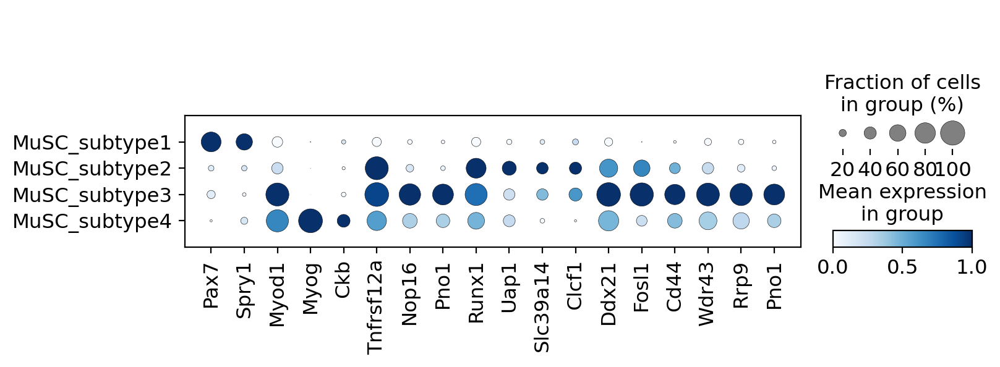

In [52]:
sc.pl.dotplot(adata_bbknn_scale_v2,['Pax7','Spry1','Myod1','Myog','Ckb','Tnfrsf12a','Nop16','Pno1','Runx1','Uap1','Slc39a14','Clcf1','Ddx21','Fosl1',
                                   'Cd44','Wdr43','Rrp9','Pno1',],groupby='annotation',categories_order=['MuSC_subtype1','MuSC_subtype2','MuSC_subtype3','MuSC_subtype4'],
              cmap='Blues',standard_scale='var',save='mouse_integrate_MuSC_bbknn_v1.0_TNF_marker.pdf')

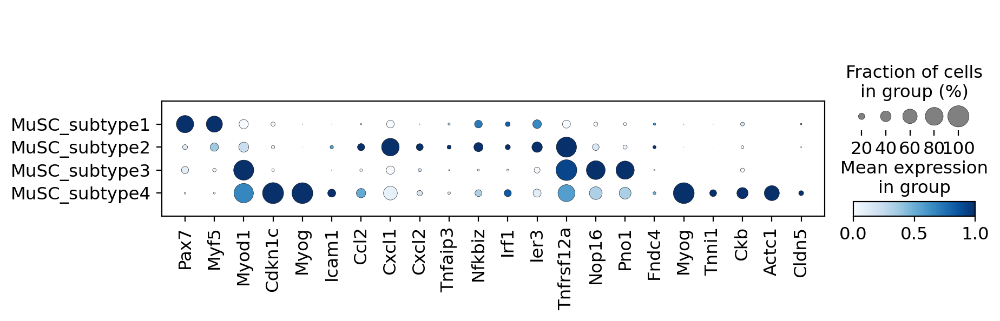

In [64]:
sc.pl.dotplot(adata_bbknn_scale_v2,['Pax7','Myf5','Myod1','Cdkn1c','Myog','Icam1','Ccl2','Cxcl1','Cxcl2','Tnfaip3','Nfkbiz','Irf1','Ier3','Tnfrsf12a','Nop16','Pno1','Fndc4','Myog','Tnni1','Ckb','Actc1','Cldn5'],groupby='annotation',categories_order=['MuSC_subtype1','MuSC_subtype2','MuSC_subtype3','MuSC_subtype4'],
              cmap='Blues',standard_scale='var',
             save='mouse_integrate_MuSC_bbknn_v1.0_TNF_marker.pdf')

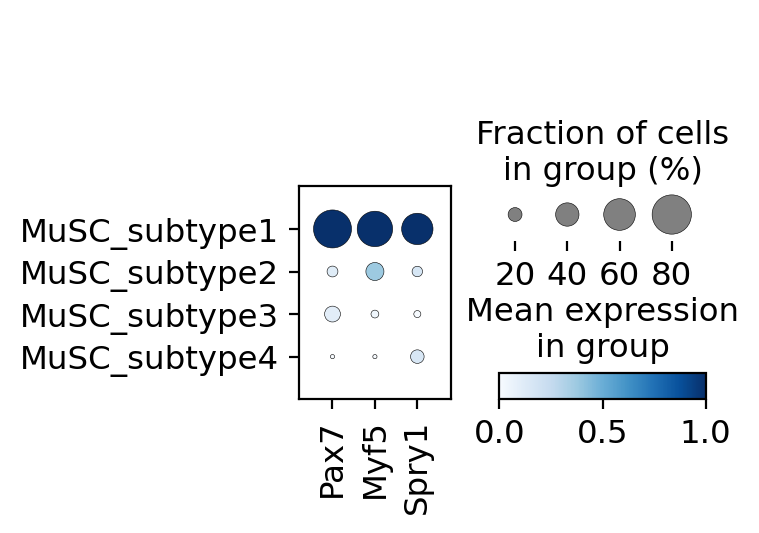

In [13]:
sc.pl.dotplot(adata_bbknn_scale_v2,['Pax7','Myf5','Spry1',],groupby='annotation',categories_order=['MuSC_subtype1','MuSC_subtype2','MuSC_subtype3','MuSC_subtype4'],
              cmap='Blues',standard_scale='var',)
             #save='mouse_integrate_MuSC_bbknn_v1.0_TNF_marker.pdf')

/home/LiuTL/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


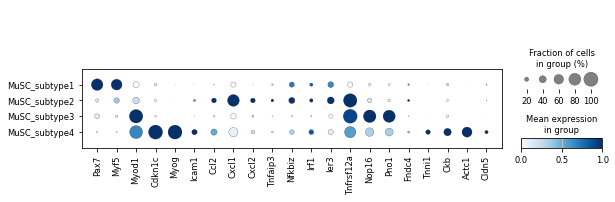

In [9]:
sc.pl.dotplot(adata_bbknn_scale_v2,['Pax7','Myf5','Myod1','Cdkn1c','Myog','Icam1','Ccl2','Cxcl1','Cxcl2','Tnfaip3','Nfkbiz','Irf1','Ier3','Tnfrsf12a','Nop16','Pno1','Fndc4','Tnni1','Ckb','Actc1','Cldn5'],groupby='annotation',categories_order=['MuSC_subtype1','MuSC_subtype2','MuSC_subtype3','MuSC_subtype4'],
              cmap='Blues',standard_scale='var',
             save='mouse_integrate_MuSC_bbknn_v1.0_TNF_marker2.pdf')

/home/LiuTL/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


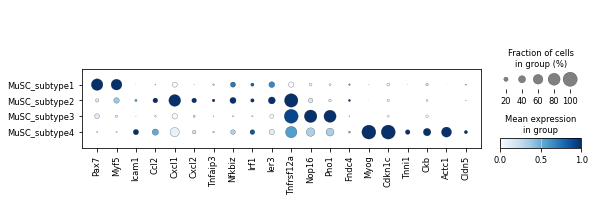

In [10]:
sc.pl.dotplot(adata_bbknn_scale_v2,['Pax7','Myf5','Icam1','Ccl2','Cxcl1','Cxcl2','Tnfaip3','Nfkbiz','Irf1','Ier3','Tnfrsf12a','Nop16','Pno1','Fndc4','Myog','Cdkn1c','Tnni1','Ckb','Actc1','Cldn5'],groupby='annotation',categories_order=['MuSC_subtype1','MuSC_subtype2','MuSC_subtype3','MuSC_subtype4'],
              cmap='Blues',standard_scale='var',)
             #save='mouse_integrate_MuSC_bbknn_v1.0_TNF_marker3.pdf')

In [ ]:
sc.pl.umap(adata_bbknn_scale_v1, color=['total_counts'],)

In [ ]:
sc.pl.umap(adata_bbknn_scale_v1, color=['total_counts'],)

In [ ]:
sc.pl.umap(adata_bbknn_scale_v1, color=['total_counts'],)

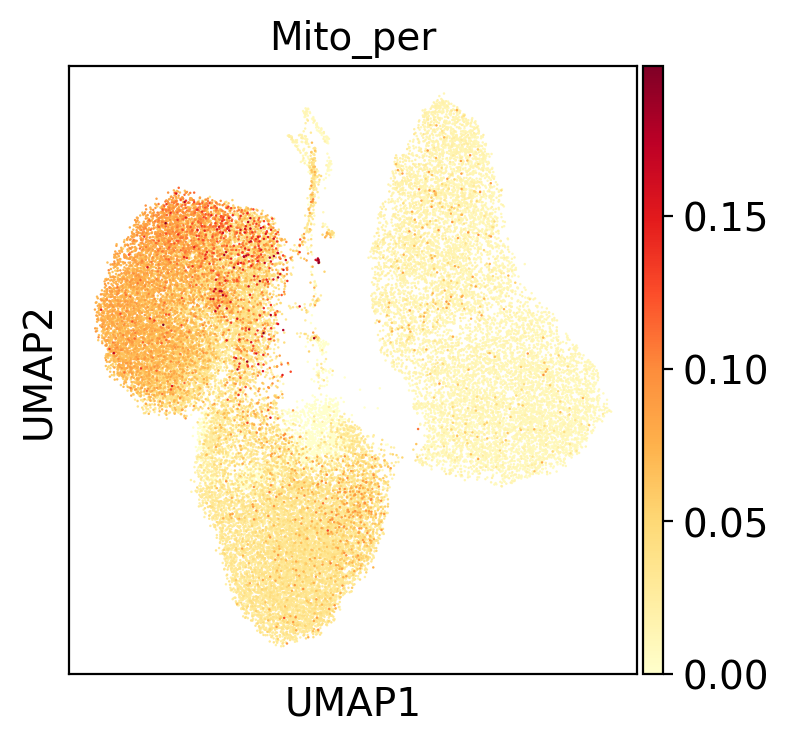

In [63]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Mito_per'],)

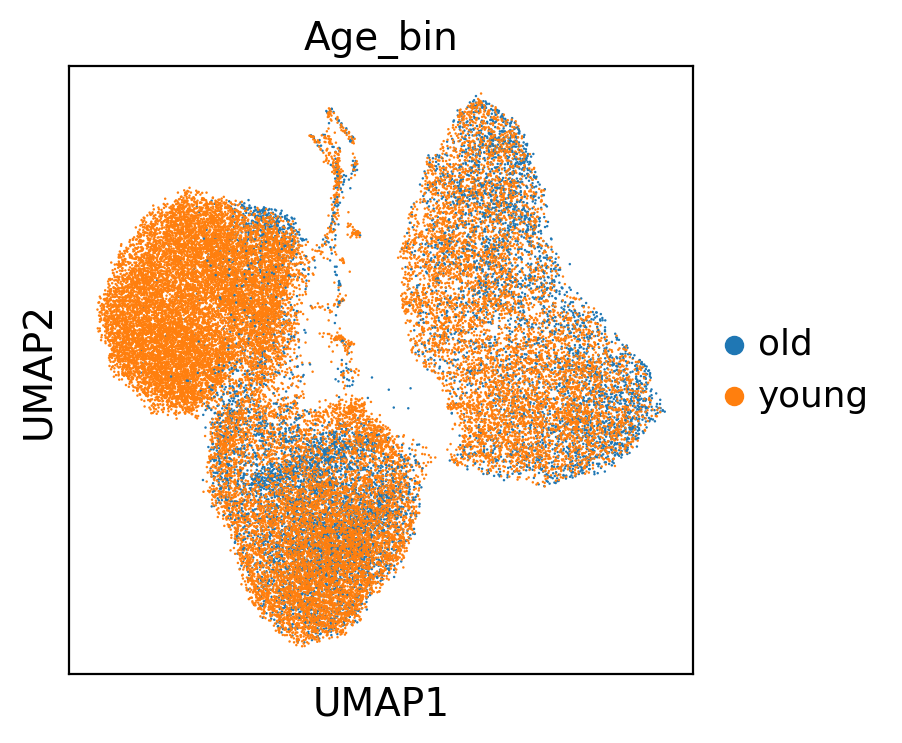

In [59]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Age_bin'],)

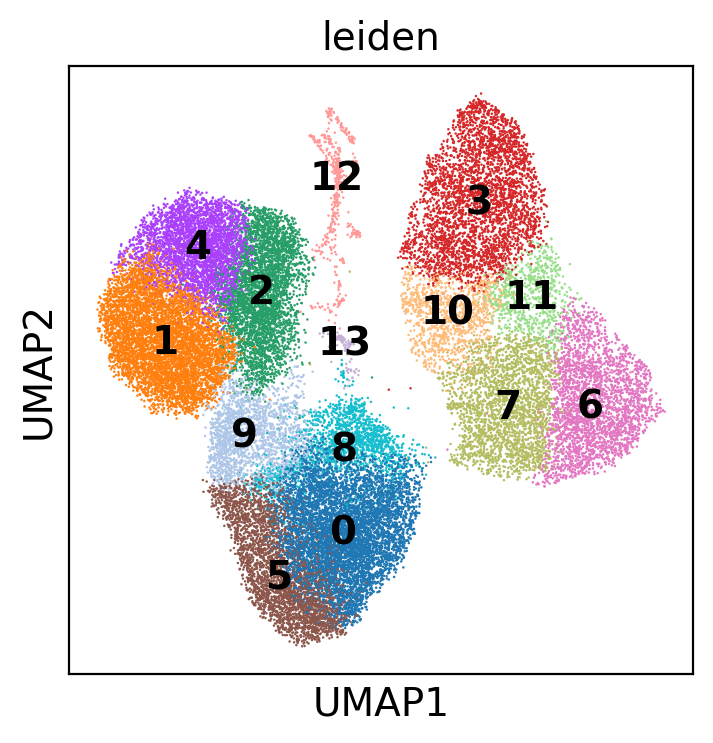

In [58]:
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden'],legend_loc='on data')

In [8]:
adata_bbknn_scale_v1

AnnData object with n_obs × n_vars = 38001 × 1657
    obs: 'batch', 'Age_bin', 'Age_mo', '10X_chemistry', 'Muscle', 'Source', 'Mito_per', 'Old_annotation', 'Sex', 'Sample_ID', 'total_annotation', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_counts', 'leiden', 'annotation'
    var: 'mito', 'gene_ids-0', 'feature_types-0', 'genome-0', 'GeneName-0', 'n_cells-1', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Muscle_colors', 'Old_annotation_colors', 'Sample_ID_colors', 'Source_colors', 'annotation_colors', 'hvg', 'leiden', 'leiden_R_colors', 'leiden_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectiv

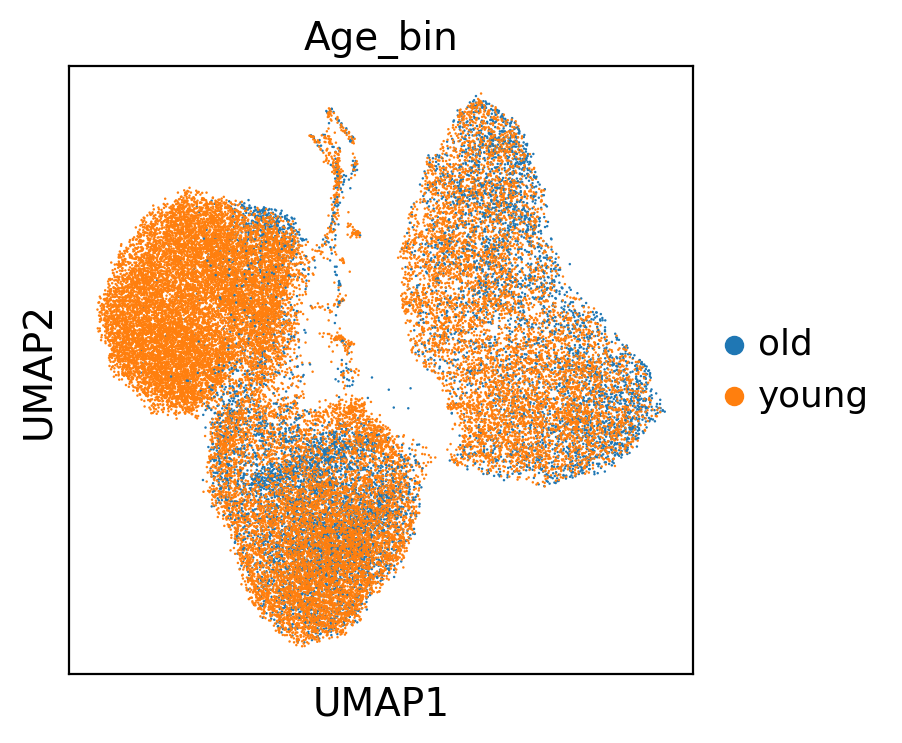

In [85]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Age_bin'],)

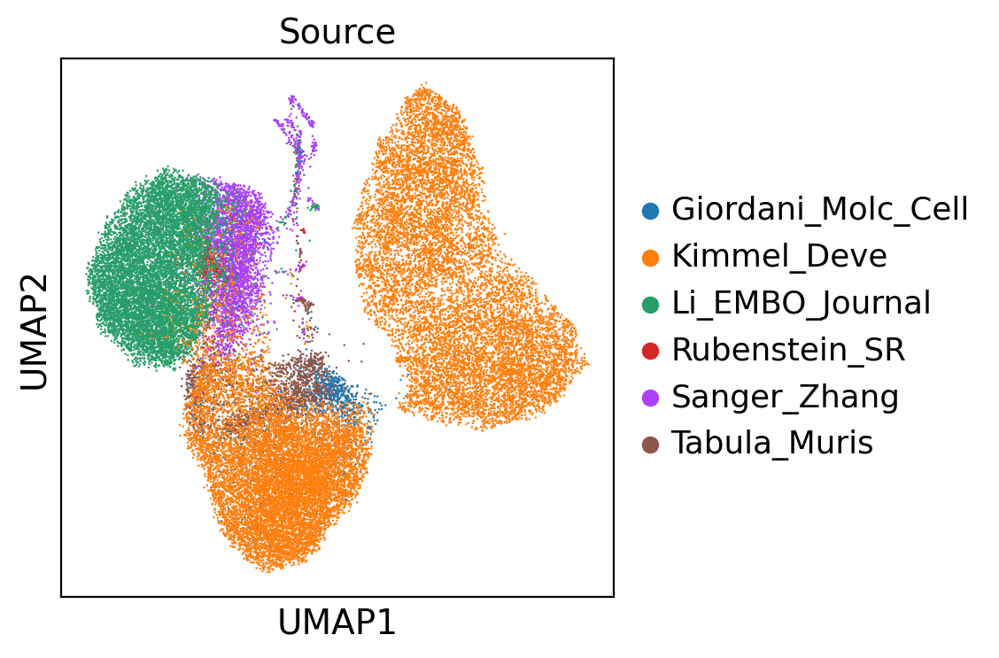

In [52]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Source'],)

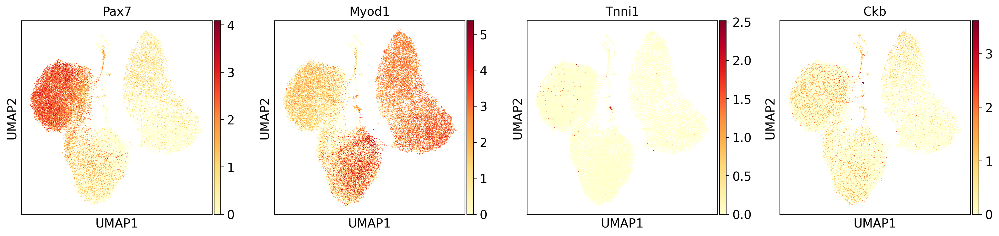

In [73]:
# 'CXCL1',
sc.pl.umap(adata_bbknn_scale_v1, color=['Pax7','Myod1','Tnni1','Ckb'],)

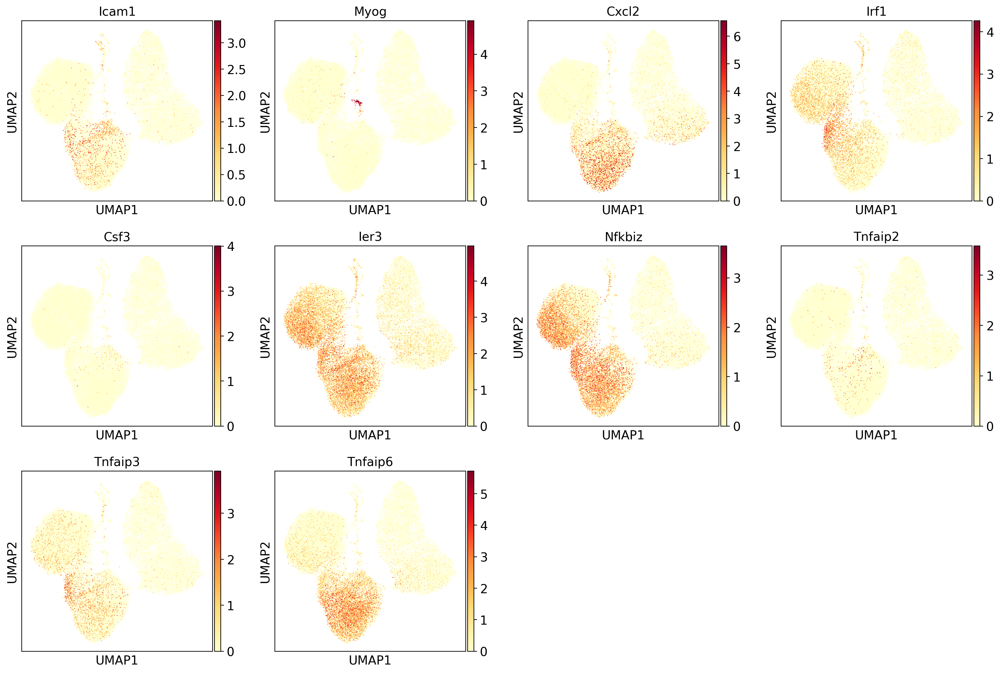

In [82]:
# 'CXCL1',
sc.pl.umap(adata_bbknn_scale_v1, color=['Icam1','Myog','Cxcl2','Irf1','Csf3','Ier3','Nfkbiz','Tnfaip2','Tnfaip3','Tnfaip6'],)

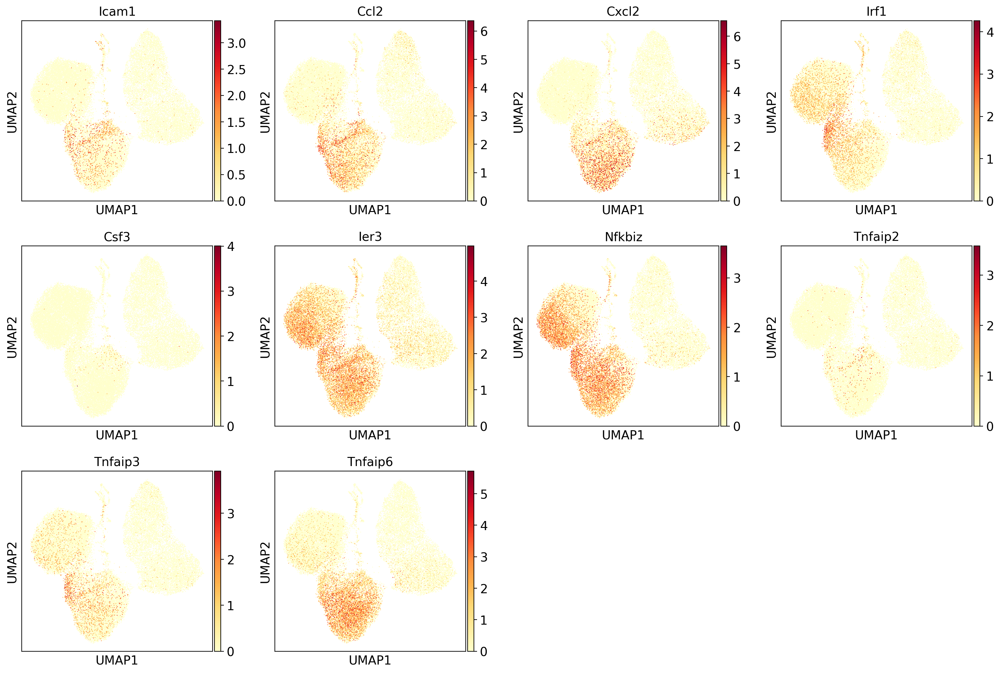

In [50]:
# 'CXCL1',
sc.pl.umap(adata_bbknn_scale_v1, color=['Icam1','Ccl2','Cxcl2','Irf1','Csf3','Ier3','Nfkbiz','Tnfaip2','Tnfaip3','Tnfaip6'],)

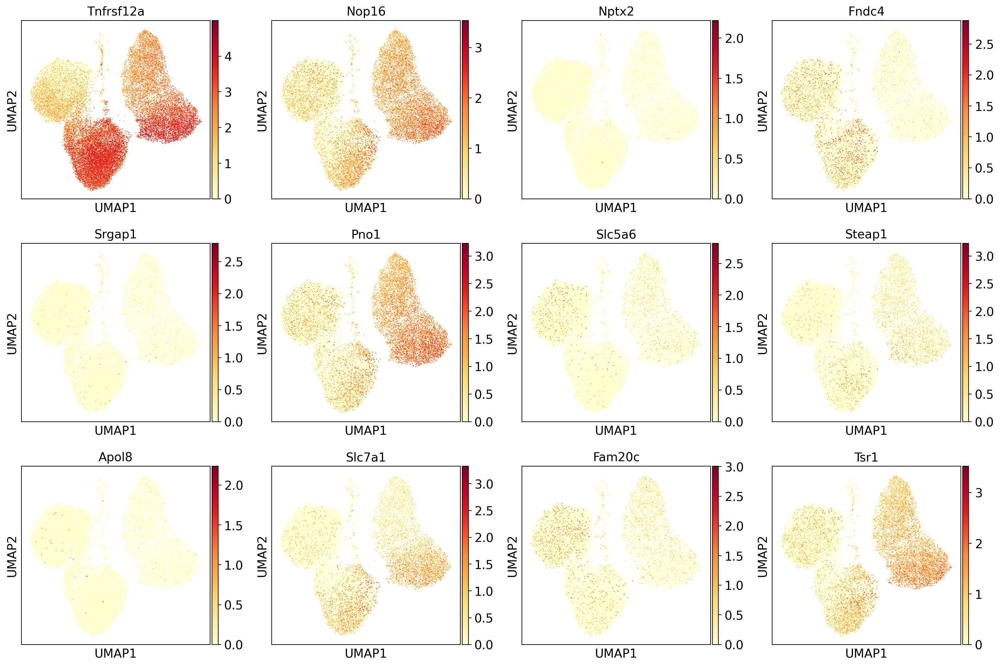

In [55]:
#  'Apol2',
sc.pl.umap(adata_bbknn_scale_v1, color=['Tnfrsf12a','Nop16','Nptx2','Fndc4','Srgap1', 'Pno1','Slc5a6', 'Steap1','Apol8', 'Slc7a1','Fam20c', 'Tsr1',], legend_fontsize=6)

In [11]:
adata_bbknn_scale_v1.obs['annotation'] = adata_bbknn_scale_v1.obs['leiden']

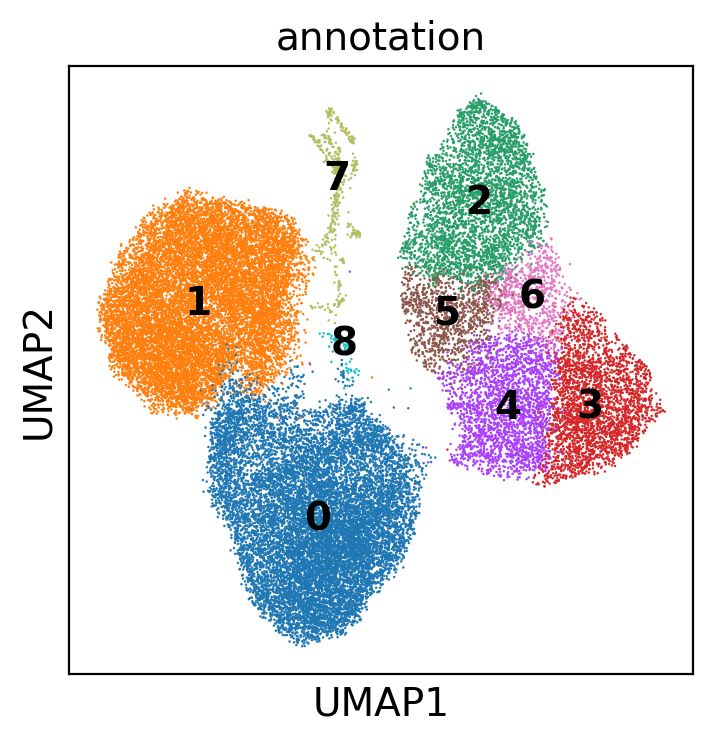

In [18]:
sc.pl.umap(adata_bbknn_scale_v1, color='annotation', legend_loc='on data',)

running Leiden clustering
    finished: found 5 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


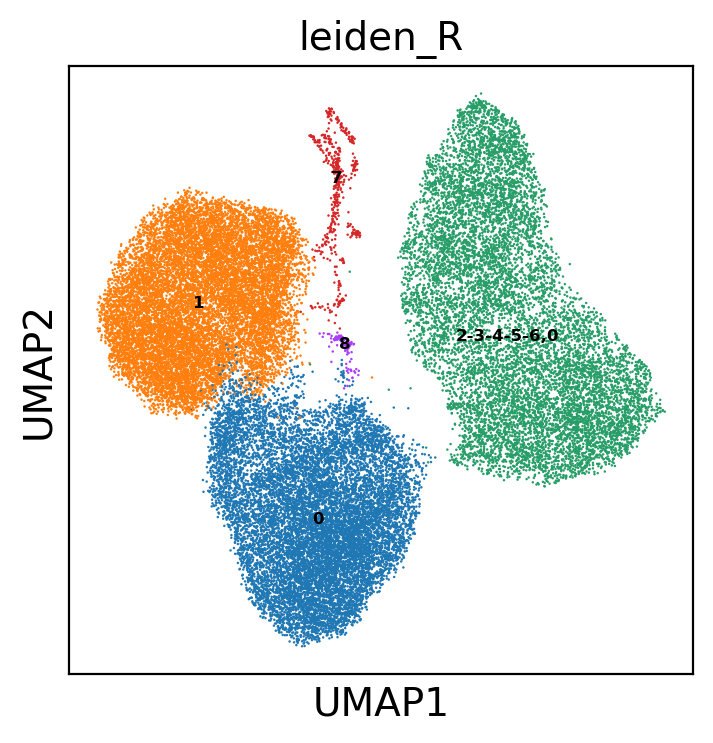

In [19]:
sc.tl.leiden(adata_bbknn_scale_v1, resolution=0.01, restrict_to=('annotation', ['2','3','4','5','6']))
sc.pl.umap(adata_bbknn_scale_v1, color='leiden_R', legend_loc='on data',legend_fontsize=6)

In [21]:
adata_bbknn_scale_v1.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata_bbknn_scale_v1.obs['leiden_R'].cat.categories))]
adata_bbknn_scale_v1.obs['annotation'] = adata_bbknn_scale_v1.obs['leiden_R']
del adata_bbknn_scale_v1.obs['leiden_R']
sc.pl.umap(adata_bbknn_scale_v1, color='annotation', legend_loc='on data',)

KeyError: 'leiden_R'

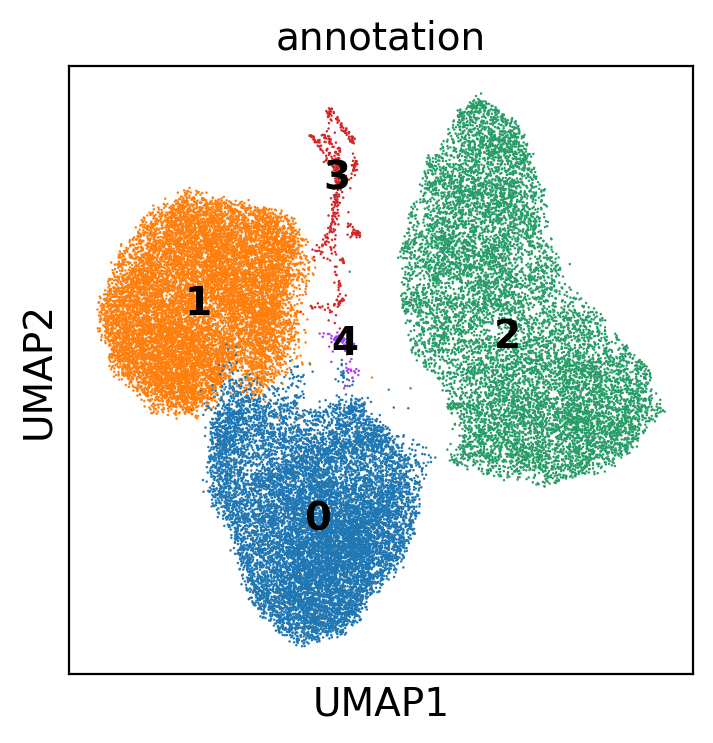

In [22]:
sc.pl.umap(adata_bbknn_scale_v1, color='annotation', legend_loc='on data',)

In [23]:
new_cluster_name = ['MuSC_subtype2','MuSC_subtype1','MuSC_subtype3',3,'MuSC_subtype4']
adata_bbknn_scale_v1.rename_categories('annotation', new_cluster_name)

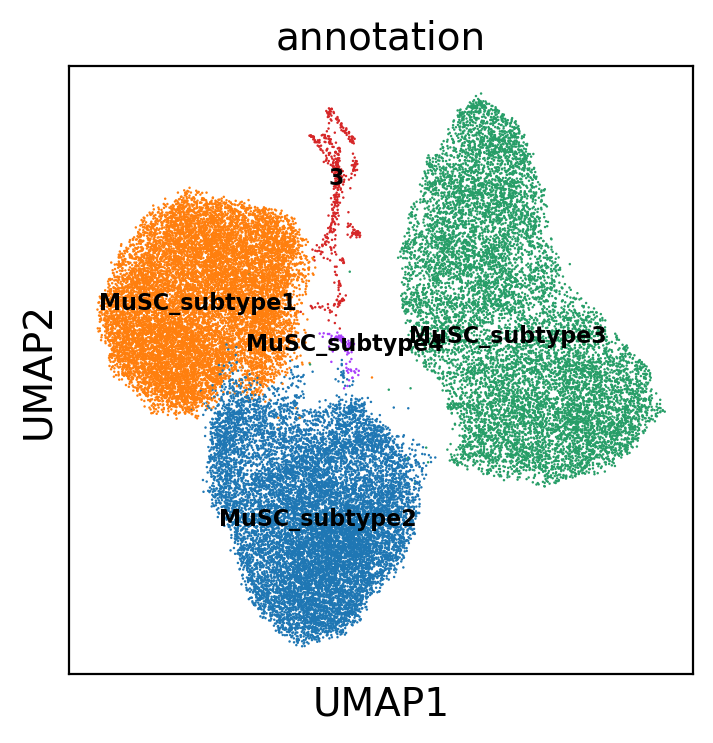

In [24]:
sc.pl.umap(adata_bbknn_scale_v1, color='annotation', legend_loc='on data',legend_fontsize=8)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:37)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:05)


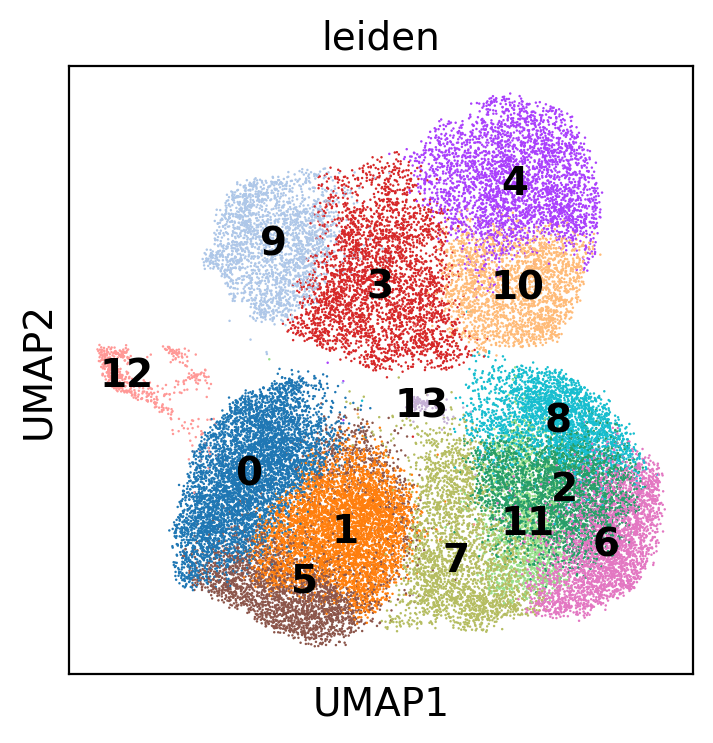

In [40]:
adata_bbknn_scale_v1 = bbknn.bbknn(adata,batch_key='Source',n_pcs=number_pcs,neighbors_within_batch=4,copy=True)
sc.tl.umap(adata_bbknn_scale_v1)
sc.tl.leiden(adata_bbknn_scale_v1,resolution=1)
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden'],legend_loc='on data')

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:41)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:11)


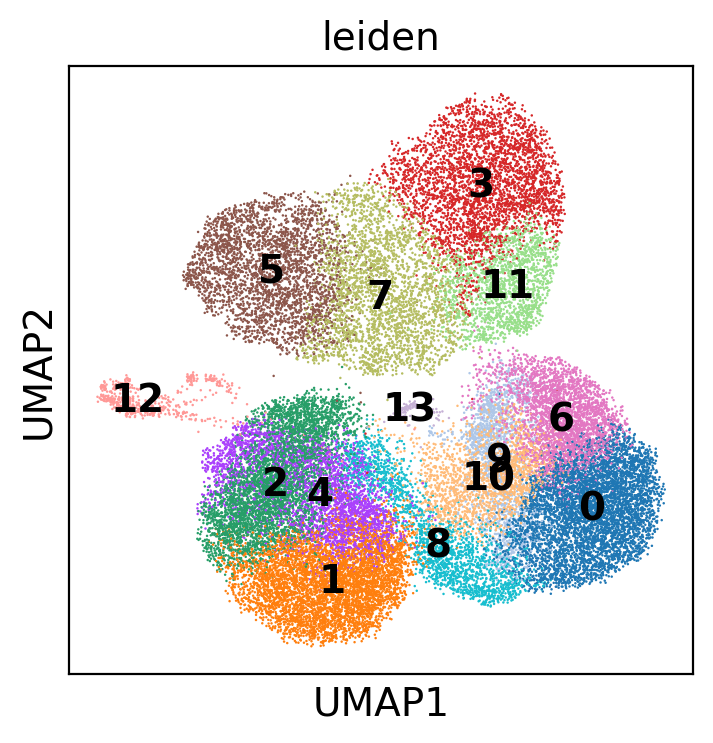

In [41]:
adata_bbknn_scale_v1 = bbknn.bbknn(adata,batch_key='Source',n_pcs=number_pcs,neighbors_within_batch=5,copy=True)
sc.tl.umap(adata_bbknn_scale_v1)
sc.tl.leiden(adata_bbknn_scale_v1,resolution=1)
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden'],legend_loc='on data')

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:45)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:10)


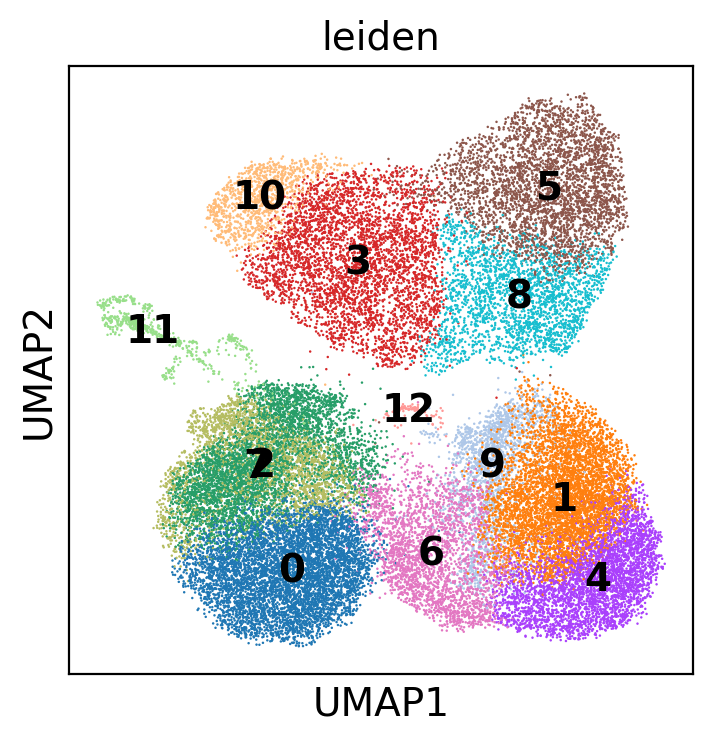

In [42]:
adata_bbknn_scale_v1 = bbknn.bbknn(adata,batch_key='Source',n_pcs=number_pcs,neighbors_within_batch=6,copy=True)
sc.tl.umap(adata_bbknn_scale_v1)
sc.tl.leiden(adata_bbknn_scale_v1,resolution=1)
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden'],legend_loc='on data')

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:08)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:46)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:14)


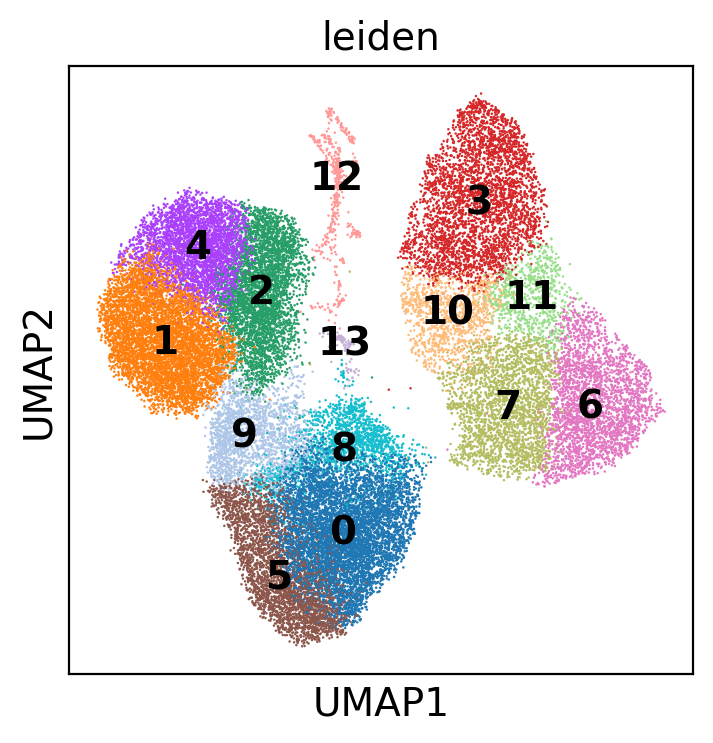

In [47]:
adata_bbknn_scale_v1 = bbknn.bbknn(adata,batch_key='Source',n_pcs=number_pcs,neighbors_within_batch=7,copy=True)
sc.tl.umap(adata_bbknn_scale_v1)
sc.tl.leiden(adata_bbknn_scale_v1,resolution=1)
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden'],legend_loc='on data')

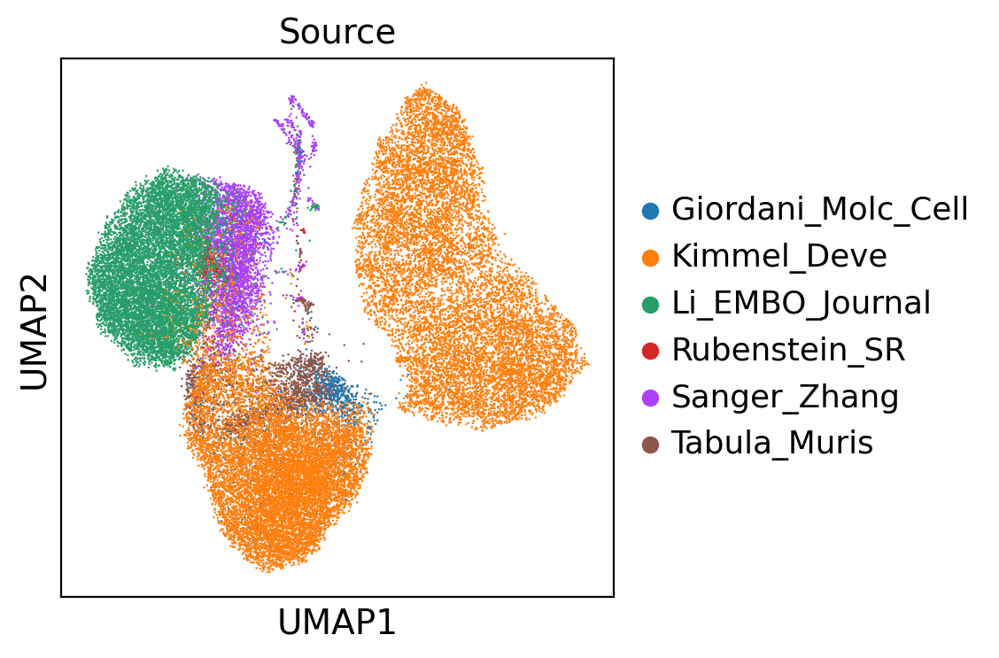

In [49]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Source'],)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:51)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:11)


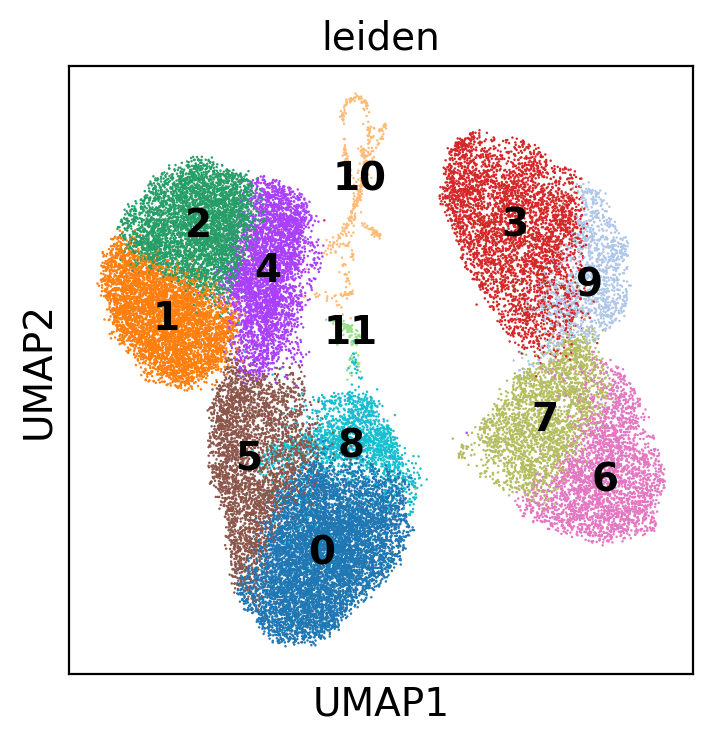

In [44]:
adata_bbknn_scale_v1 = bbknn.bbknn(adata,batch_key='Source',n_pcs=number_pcs,neighbors_within_batch=8,copy=True)
sc.tl.umap(adata_bbknn_scale_v1)
sc.tl.leiden(adata_bbknn_scale_v1,resolution=1)
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden'],legend_loc='on data')

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:51)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:21)


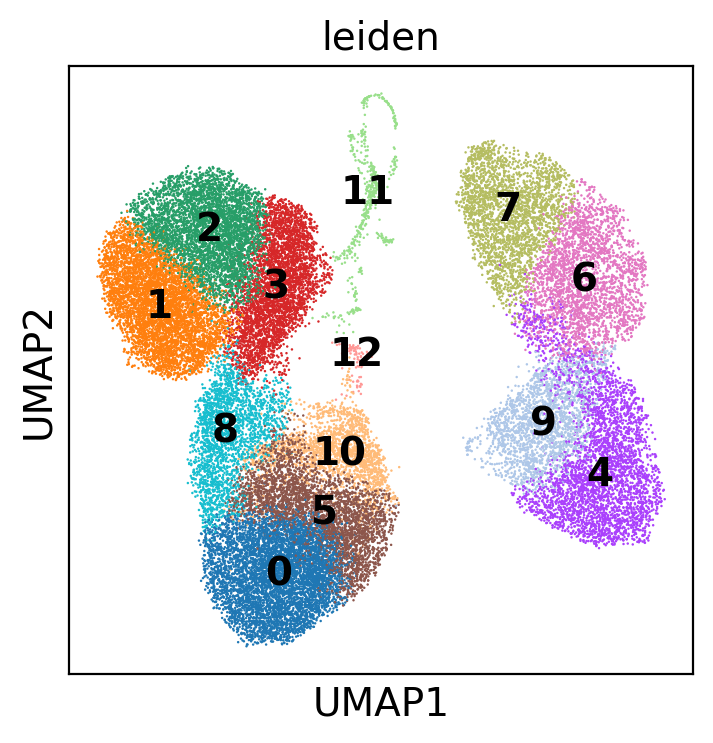

In [45]:
adata_bbknn_scale_v1 = bbknn.bbknn(adata,batch_key='Source',n_pcs=number_pcs,neighbors_within_batch=9,copy=True)
sc.tl.umap(adata_bbknn_scale_v1)
sc.tl.leiden(adata_bbknn_scale_v1,resolution=1)
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden'],legend_loc='on data')

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:10)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:52)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:21)


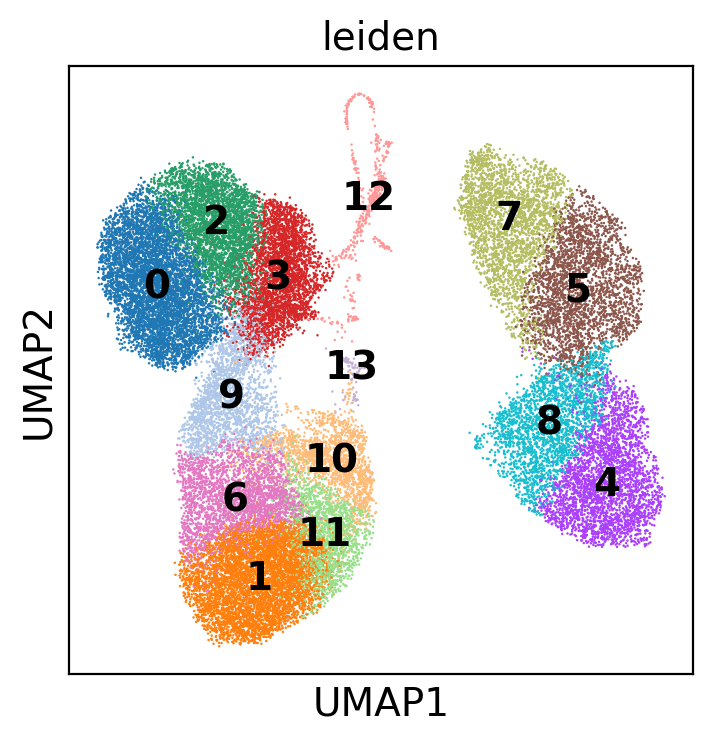

In [46]:
adata_bbknn_scale_v1 = bbknn.bbknn(adata,batch_key='Source',n_pcs=number_pcs,neighbors_within_batch=10,copy=True)
sc.tl.umap(adata_bbknn_scale_v1)
sc.tl.leiden(adata_bbknn_scale_v1,resolution=1)
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden'],legend_loc='on data')